In [2]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
from shapely.geometry import Polygon, Point
import pandas as pd
import cv2
from pyproj import Transformer
import rasterio
from rasterio.plot import show
import os

(69568, 702)


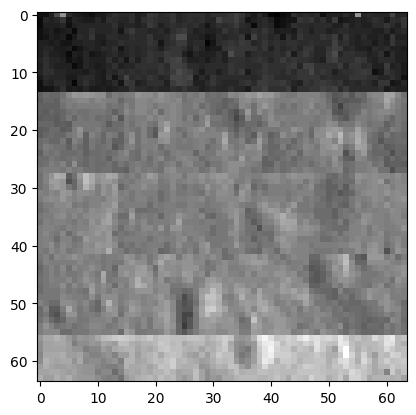

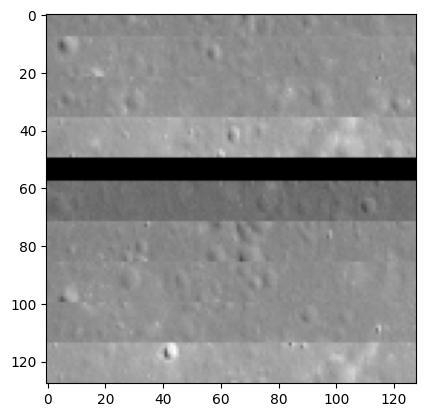

In [157]:
# Define image dimensions
width = 704
height = 48988544 // width
# Load .IMG file
img_data = np.fromfile('data/lro/M1471128346CE.IMG', dtype=np.uint8)



black_band_height = 8 #checked

offset_left = 2 #checked

offset_top = 10 + black_band_height

img_data = img_data.reshape(height, width)
img_data = img_data[offset_top:, offset_left:]
print(img_data.shape)

img_lt = Image.fromarray(img_data[:64, :64])
img_br = Image.fromarray(img_data[-128:, -128:])

plt.imshow(img_lt, cmap='gray')
plt.show()

plt.imshow(img_br, cmap='gray')
plt.show()

(128, 14)


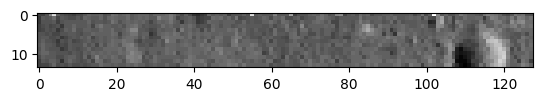

In [161]:
framelet_height = 14
example_framelet = Image.fromarray(img_data[:framelet_height,:128])

print(example_framelet.size)

plt.imshow(example_framelet, cmap='gray')
plt.show()

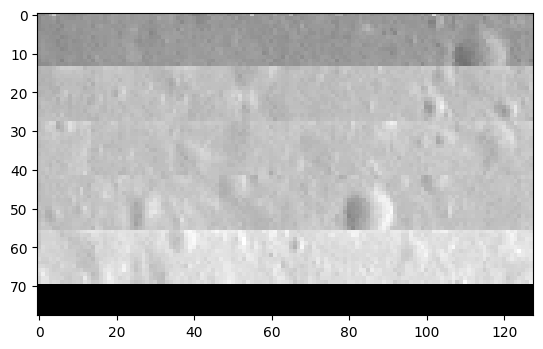

In [164]:
first_frame = Image.fromarray(img_data[:framelet_height*5+black_band_height,:128])
plt.imshow(first_frame, cmap='gray')


In [166]:
num_frames = 892

In [169]:
strips = []
strip_height = 14  # Height of each strip
band_height = 8    # Height of the black band
frame_height = 5 * strip_height + band_height  # Total height of 5 strips + 1 band

for i in range(num_frames):
    frame_start = i * frame_height

    single_frame = []

    for j in range(5):  # 5 strips per frame
        strip_start = frame_start + j * strip_height
        strip = img_data[strip_start:strip_start + strip_height, :]
        strips.append(strip)

In [173]:
len(strips)

4460

In [174]:
892*5

4460

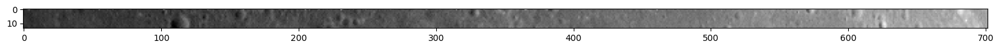

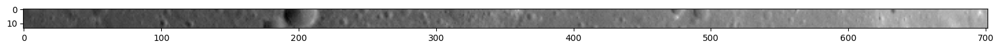

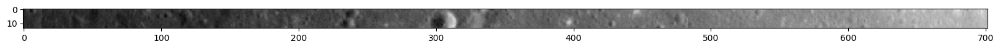

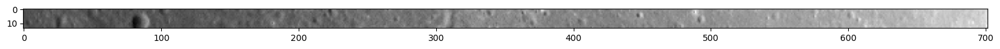

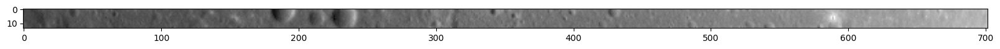

...

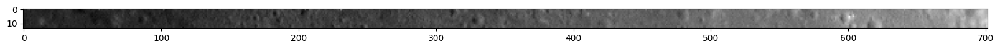

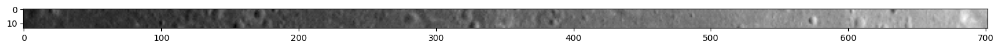

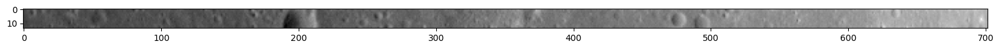

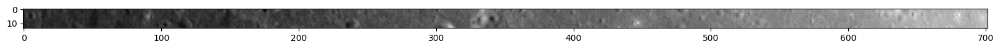

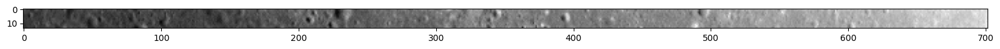

In [188]:
import matplotlib.pyplot as plt

for strip in strips[:20]:
    plt.figure(figsize=(20, 20))
    plt.imshow(strip, cmap='gray')
    plt.show()

In [190]:
def process_image_strips(img_data, num_frames):
    strip_height = 14  # Height of each strip
    band_height = 8    # Height of the black band
    frame_height = 5 * strip_height + band_height  # Total height of 5 strips + 1 band

    processed_frames = []

    for i in range(num_frames):
        frame_start = i * frame_height
        frame_strips = []

        for j in range(5):  # 5 strips per frame
            strip_start = frame_start + j * strip_height
            strip = img_data[strip_start:strip_start + strip_height, :]
            frame_strips.append(strip)

        # Vertically stack the 5 strips
        stacked_frame = np.vstack(frame_strips)
        processed_frames.append(stacked_frame)

    return processed_frames

In [191]:
processed_frames = process_image_strips(img_data, num_frames)
print(len(processed_frames))

892


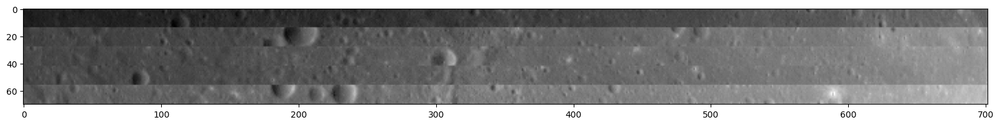

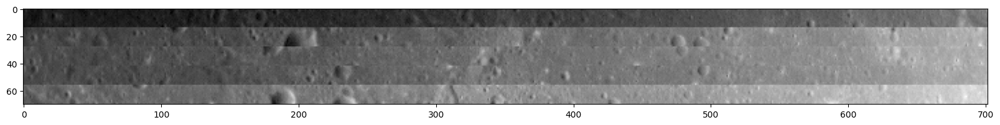

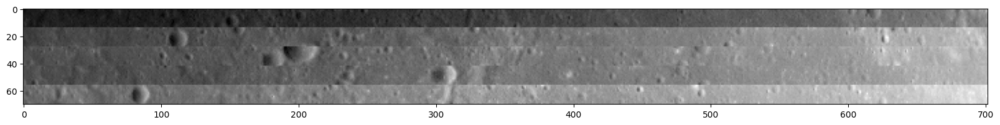

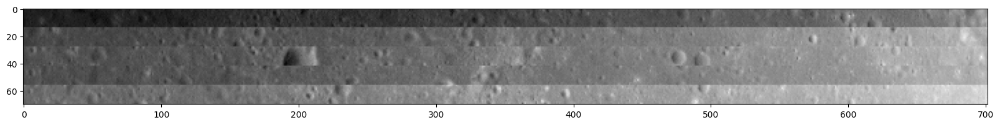

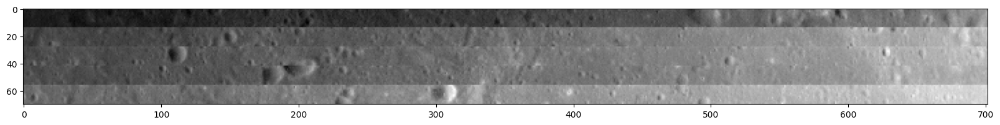

...

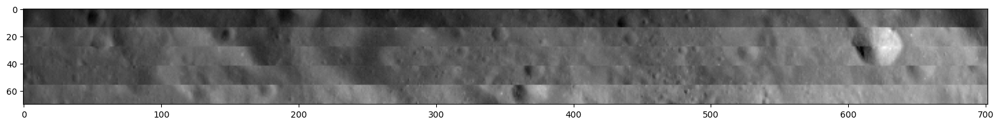

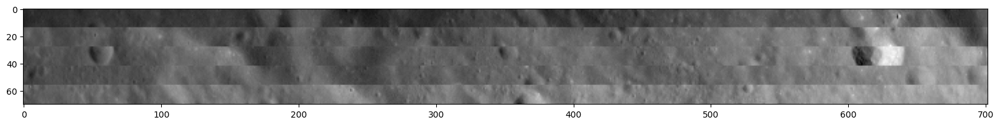

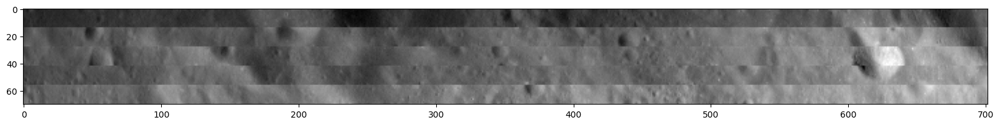

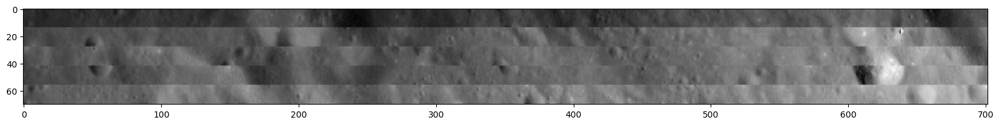

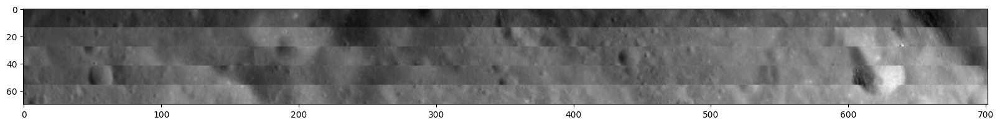

In [193]:
for frame in processed_frames[:100]:
    plt.figure(figsize=(20, 20))
    plt.imshow(frame, cmap='gray')
    plt.show()